# Dependencies

In [29]:
import os

import numpy as np
import scipy.io
from PIL import Image

%matplotlib inline
import plotly
from matplotlib import pyplot as plt
from plotly.graph_objs import Bar, Layout, Scatter
from plotly.graph_objs.layout import XAxis, YAxis
from scipy import ndimage as ndi
from skimage.color import rgb2gray
from skimage.feature import corner_harris, corner_peaks, daisy
from skimage.filters import gabor_kernel
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score, mean_squared_error
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC


# Business Understanding

This dataset contains 1360 jpg images of flowers that are commonly found across the United Kingdom. These flowers vary in size, shape, and coloration, making them well-suited for classification tasks. While the dataset's original purpose is not explicitly stated by its creators, it is likely designed for machine learning applications, such as the one we are developing.

Flower classification has several real-world applications across different industries. Botanists may be interested in identifying flower species or even discovering new flower species. App developers could leverage this dataset to create AI-powered identification apps, allowing users to recognize flowers in real time using their smartphone cameras. Gardeners and farmers may even be interested in this technology for pest/disease detection, ensuring the health of their vegetation.

For this project, we consider classification accuracy as a key performance metric. An accuracy score of 0.8 or higher would provide valuable insights for scientists and agricultural professionals worldwide. However, given the precision required in scientific research, an accuracy of 0.9 or above would be significantly more impactful. The higher the accuracy, the more reliable the model’s predictions, making it a valuable tool for research, conservation, and commercial applications.

# Data Preparation

## Read images
- Read in your images as numpy arrays. Resize and recolor images as necessary. 

In [2]:
# classpaths
dataset_path = "oxfordflower17/jpg"
label_file = "oxfordflower17/imagelabels.mat"

# Get sorted image filenames
image_files = sorted(os.listdir(dataset_path))
image_files = [f for f in image_files if f.endswith(".jpg")]

image_arrays = []

# Read in your images as numpy arrays, Resize and recolor images.
for file in image_files:
    img_path = os.path.join(dataset_path, file)
    img = Image.open(img_path).convert("RGB")
    # Resize image
    img = img.resize((128, 128))
    # Read images as numpy arrays
    img_array = np.array(img)

    image_arrays.append(img_array)

# Convert list to NumPy array
image_arrays = np.array(image_arrays)

labels_data = scipy.io.loadmat(label_file)

# get labels--y
y = labels_data["labels"][0]


n_samples, h, w, ch = image_arrays.shape
n_classes = len(np.unique(y))

print("Image dataset shape:", image_arrays.shape)
print(np.sum(~np.isfinite(image_arrays)))
print(f"n_samples: {n_samples}")
print(f"n_features: {h * w * ch}")
print(f"n_classes: {n_classes}")
print(f"Original Image Sizes {h} by {w}")


Image dataset shape: (1360, 128, 128, 3)
0
n_samples: 1360
n_features: 49152
n_classes: 17
Original Image Sizes 128 by 128


## Linearize the images
- Linearize the images to create a table of 1-D image features (each row should be one image).  
- The origina dataset does not contains the label name. To better understand the label name, we preprosse it. 

In [3]:
X = image_arrays.reshape(image_arrays.shape[0], -1)
print("Flattened image dataset shape:", X.shape)

# Attach Labels to the Feature Table
dataset_with_labels = np.column_stack((X, y))

# Print the new dataset shape
print("Final dataset shape (features + label):", dataset_with_labels.shape)

category_names = {
    1: "Daffodil",
    2: "Snowdrop",
    3: "Lily Valley",
    4: "Bluebell",
    5: "Crocus",
    6: "Iris",
    7: "Tigerlily",
    8: "Tulip",
    9: "Fritillary",
    10: "Sunflower",
    11: "Daisy",
    12: "Coltsfoot",
    13: "Dandelion",
    14: "Cowslip",
    15: "Buttercup",
    16: "Windflower",
    17: "Pansy",
}

names = np.array([category_names[label] for label in y])

print("First 10 flower names:", names[:10])


Flattened image dataset shape: (1360, 49152)
Final dataset shape (features + label): (1360, 49153)
First 10 flower names: ['Daffodil' 'Daffodil' 'Daffodil' 'Daffodil' 'Daffodil' 'Daffodil'
 'Daffodil' 'Daffodil' 'Daffodil' 'Daffodil']


## Visualize several images.

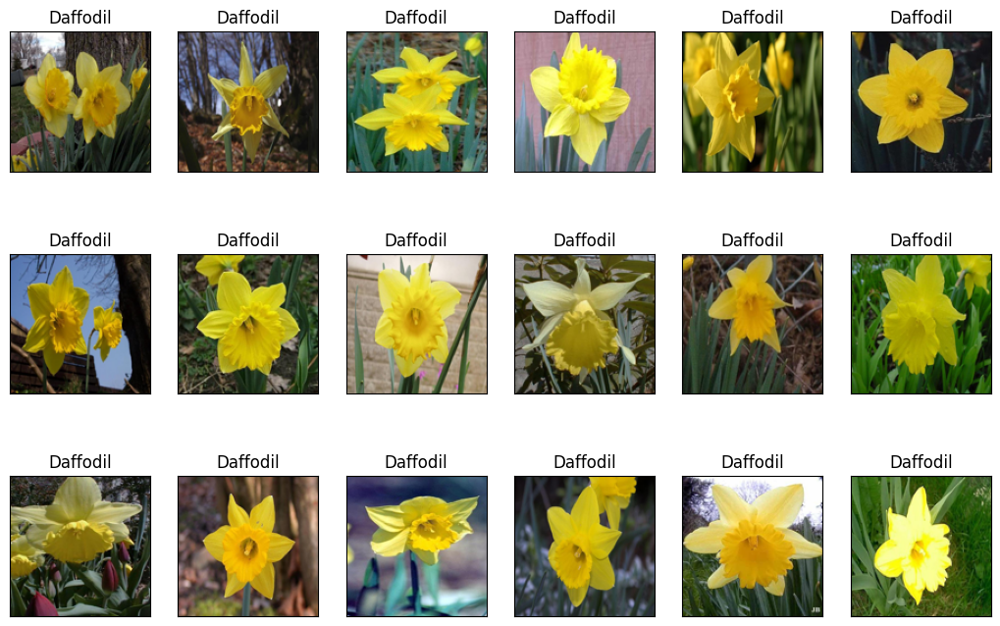

In [4]:
# a helper plotting function
def plot_gallery(images, titles, h, w, ch, n_row=3, n_col=6):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(1.7 * n_col, 2.3 * n_row))
    plt.subplots_adjust(
        bottom=0,
        left=0.01,
        right=0.99,
        top=0.90,
        hspace=0.35,
    )
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i].reshape((h, w, ch)), cmap=plt.cm.gray)
        plt.title(titles[i], size=12)
        plt.xticks(())
        plt.yticks(())


plot_gallery(
    X,
    names,
    h,
    w,
    ch,
)  # defaults to showing a 3 by 6 subset of the faces
plt.show()

# Data Reduction 

## Dimensionality Reduction Using Full PCA

In [5]:
# lets do some PCA of the features and go from 1850 features to 500 features
n_components = 500
print(
    "Extracting the top %d eigenfaces from %d faces"
    % (n_components, X.shape[0]),
)

pca = PCA(n_components=n_components)
%time pca.fit(X.copy())
eigenfaces = pca.components_.reshape((n_components, h, w, ch))

Extracting the top 500 eigenfaces from 1360 faces
CPU times: user 9.14 s, sys: 837 ms, total: 9.98 s
Wall time: 8.5 s


In [6]:
# manipulated from Sebastian Raschka Example (your book!)
# also from blog here: http://sebastianraschka.com/Articles/2015_pca_in_3_steps.html

# this is a scree plot
def plot_explained_variance(pca):
    plotly.offline.init_notebook_mode()  # run at the start of every notebook

    explained_var = pca.explained_variance_ratio_
    cum_var_exp = np.cumsum(explained_var)

    plotly.offline.iplot(
        {
            "data": [
                Bar(y=explained_var, name="individual explained variance"),
                Scatter(
                    y=cum_var_exp,
                    name="cumulative explained variance",
                ),
            ],
            "layout": Layout(
                xaxis=XAxis(title="Principal components"),
                yaxis=YAxis(title="Explained variance ratio"),
            ),
        },
    )


plot_explained_variance(pca)
pca_variance = np.sum(pca.explained_variance_ratio_)
print(f"Explained Variance with Standard PCA: {pca_variance}")

Explained Variance with Standard PCA: 0.9240119745121339



From the above explained variance plot, we can see:

1. the explained variance ratio increases as the the number of the principal components increases
2. when principal components reaches around 500, the explained variance ratio would be 0.9240200221980395, greater than 90%, meaning 500 principal components have alread capture 90%+ information. This suggest 500 principal components would adequately represent our image data.
3. Therefore, we can set n_components = 500

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0011267658529896167..0.007084972371288476].


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.005059610430329097..0.011130768373869619].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.00513612527606955..0.014143616589129389].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.007812839202042295..0.010034831312846495].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.008948272318463514..0.01644334434541227].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.012479510798844205..0.014613513220208034].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.009245027731734476..0.013090092867790616].


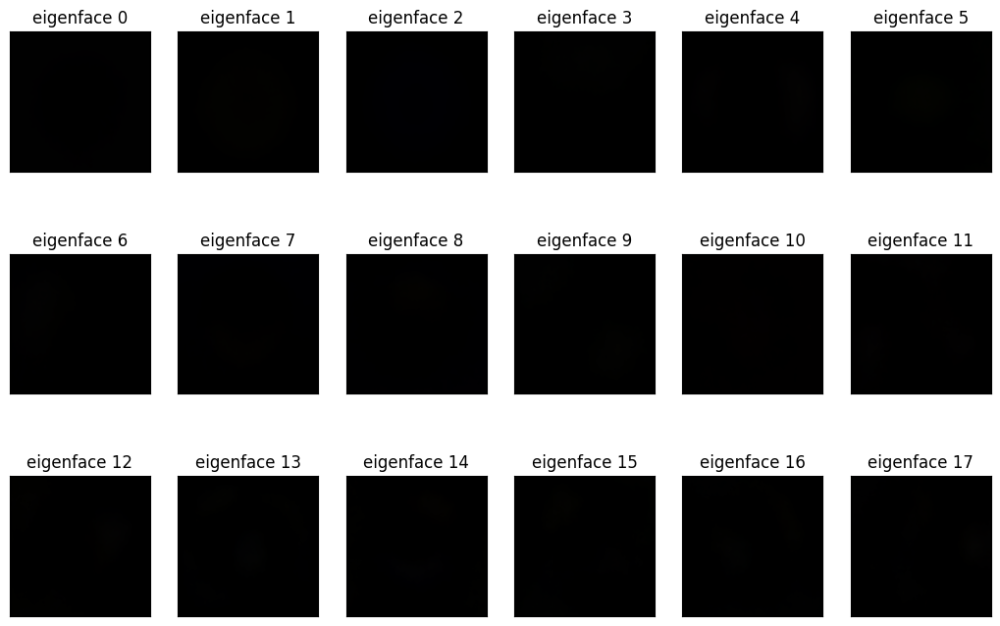

In [7]:
eigenface_titles = ["eigenface %d" % i for i in range(eigenfaces.shape[0])]
plot_gallery(eigenfaces, eigenface_titles, h, w, ch)
plt.show()

### Note
From above visualization, we found that eigenfaces are appearing black. Through research, we found that it is because PCA components contain both positive and negative values, and above imshow() function expects values in the positive range.

Therefore, we need to normalize the PCA components (eigenfaces) to scale values to a valid range([0.0,1.0]) for display, by defining the function normalize_eigenfaces(eigenfaces)

In [8]:
def normalize_eigenfaces(eigenfaces):
    eigenfaces_normalized = (eigenfaces - np.min(eigenfaces)) / (
        np.max(eigenfaces) - np.min(eigenfaces)
    )
    return eigenfaces_normalized

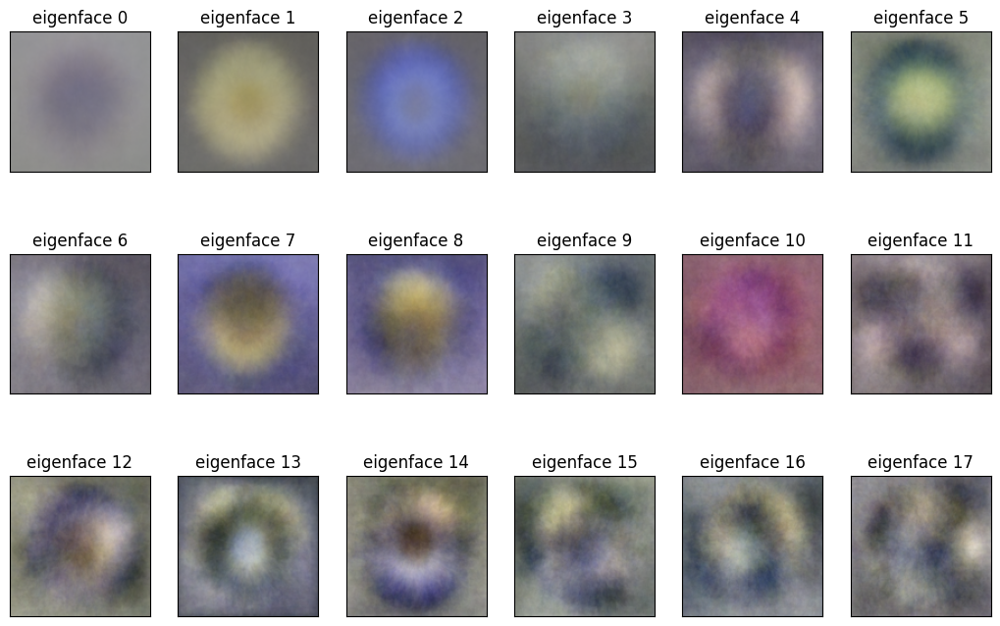

In [9]:
plot_gallery(normalize_eigenfaces(eigenfaces), eigenface_titles, h, w, ch)
plt.show()

In [10]:
def reconstruct_image(trans_obj, org_features):
    low_rep = trans_obj.transform(org_features)
    rec_image = trans_obj.inverse_transform(low_rep)
    return low_rep, rec_image


idx_to_reconstruct = 1
X_idx = X[idx_to_reconstruct]
low_dimensional_representation, reconstructed_image = reconstruct_image(
    pca,
    X_idx.reshape(1, -1),
)

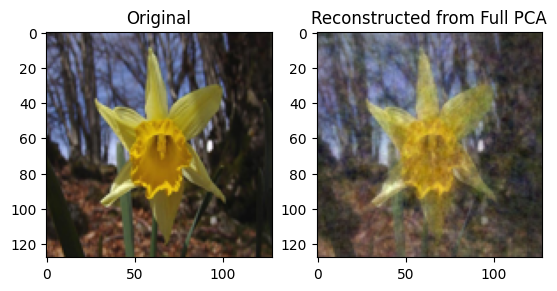

In [11]:
# Reshape reconstructed image back to (h, w, 3)
reconstructed_image_reshape = reconstructed_image.reshape((h, w, ch))

# Normalize for display (optional)

plt.subplot(1, 2, 1)
plt.imshow(X_idx.reshape((h, w, ch)), cmap=plt.cm.gray)
plt.title("Original")
plt.grid(False)
plt.subplot(1, 2, 2)
plt.imshow(normalize_eigenfaces(reconstructed_image_reshape))
plt.title("Reconstructed from Full PCA")
plt.grid(False)
plt.show()

## Dimensionality Reduction Using Randomized PCA

In [12]:
# lets do some PCA of the features and go from 1850 features to 500 features

n_components = 500
print(
    "Extracting the top %d eigenfaces from %d faces"
    % (n_components, X.shape[0]),
)

rpca = PCA(n_components=n_components, svd_solver="randomized")
%time rpca.fit(X.copy())
eigenfaces = rpca.components_.reshape((n_components, h, w, ch))

Extracting the top 500 eigenfaces from 1360 faces
CPU times: user 8.95 s, sys: 822 ms, total: 9.78 s
Wall time: 8.34 s


In [13]:
plot_explained_variance(rpca)
rand_pca_variance = np.sum(rpca.explained_variance_ratio_)
print(f"Explained Variance with Randomized PCA: {rand_pca_variance}")

Explained Variance with Randomized PCA: 0.9240129500705916


From the above explained variance plot, we can see the trends similiar to the full PCA:

1. the explained variance ratio increases as the the number of the principal components increases
2. when principal components reaches around 500, the explained variance ratio is 0.9239806422583094, greater than 90%, meaning 500 principal components have alread capture 90%+ information. This suggest 500 principal components would adequately represent our image data.
3. Therefore, we can set n_components = 500

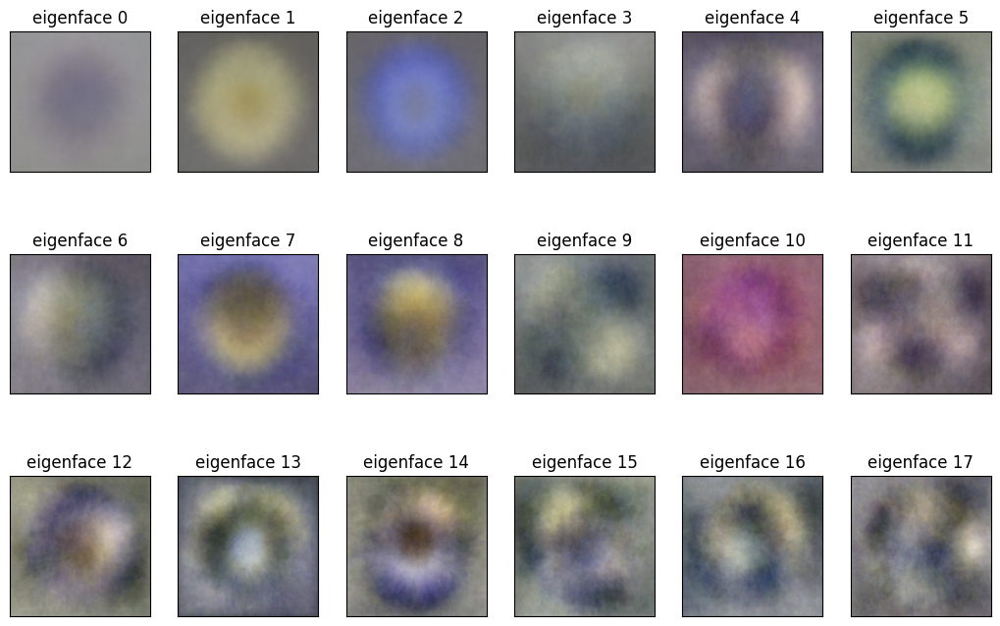

In [14]:
eigenface_titles = ["eigenface %d" % i for i in range(eigenfaces.shape[0])]
plot_gallery(normalize_eigenfaces(eigenfaces), eigenface_titles, h, w, ch)
plt.show()

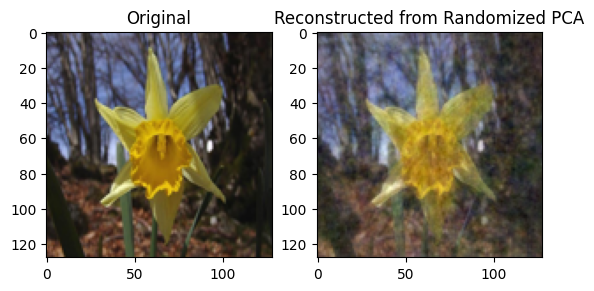

In [15]:
low_dimensional_representation_r, reconstructed_image_r = (
    reconstruct_image(rpca, X_idx.reshape(1, -1))
)

# Reshape reconstructed image back to (h, w, 3)
reconstructed_image_reshape_r = reconstructed_image_r.reshape((h, w, 3))

# Normalize for display (optional)

plt.subplot(1, 2, 1)
plt.imshow(X_idx.reshape((h, w, ch)), cmap=plt.cm.gray)
plt.title("Original")
plt.grid(False)
plt.subplot(1, 2, 2)
plt.imshow(normalize_eigenfaces(reconstructed_image_reshape_r))
plt.title("Reconstructed from Randomized PCA")
plt.grid(False)
plt.show()

## Compare the representation using PCA and Randomized PCA.

To compare Full PCA and Randomized PCA, we can 
1. compare there explained_variance of both two PCA based on the same number of Principal components(n_components=500)
2. Compare Reconstruction Quality

In [16]:
# Compare Explained Variance
print("Explained Variance as follows:")
print(f"Full       PCA: {pca_variance}")
print(f"Randomized PCA: {rand_pca_variance}")
print(
    f"Explained Variance diff(Full PCA-Randomized PCA):  {pca_variance - rand_pca_variance}",
)

# Compare MSE
mse_pca = mean_squared_error(X_idx.reshape(1, -1), reconstructed_image)
mse_rand_pca = mean_squared_error(
    X_idx.reshape(1, -1),
    reconstructed_image_r,
)

print("----------------------------------------------------")
print("MSE as follows:")
print(f"Full       PCA: {mse_pca}")
print(f"Randomized PCA: {mse_rand_pca}")

Explained Variance as follows:
Full       PCA: 0.9240119745121339
Randomized PCA: 0.9240129500705916
Explained Variance diff(Full PCA-Randomized PCA):  -9.755584576831566e-07
----------------------------------------------------
MSE as follows:
Full       PCA: 161.90132714415412
Randomized PCA: 151.95987700824153


## Analysis

From the comparsion regarding Explained Variance and MSE, we can see:
1. The variance of Randomized PCA is just slightly smaller than that of Full PCA(very close), meaning that  Randomized PCA is a good approximation.
2. The MSE of Randomized PCA is lower than that of Full PCA, meaning that  better Randomized PCA have a better reconstruction quality.

## Feature Extraction using Gabor Filters

In [17]:
def compute_gabor_filters(frequencies, thetas):
    """Generates a list of Gabor kernels for specified frequencies and orientations."""
    kernels = []
    for freq in frequencies:
        for theta in thetas:
            kernel = gabor_kernel(freq, theta=theta)
            kernels.append(kernel)
    return kernels


def apply_gabor_filters(image, kernels):
    """Applies a list of Gabor filters to an image."""
    filtered_images = []
    for kernel in kernels:
        filtered_channels = []
        for channel in range(image.shape[2]):
            filtered = ndi.convolve(
                image[:, :, channel], kernel, mode="wrap"
            )
            filtered_channels.append(filtered)
        filtered_images.append(np.stack(filtered_channels, axis=2))
    return np.stack(filtered_images, axis=0)


frequencies = [0.1, 0.3]
# Orientations from 0 to 180 degrees in steps of 45 degrees
thetas = np.arange(0, np.pi, np.pi / 4)
gabor_kernels = compute_gabor_filters(frequencies, thetas)

filtered_image_list = [
    apply_gabor_filters(image, gabor_kernels) for image in image_arrays
]

## Analysis

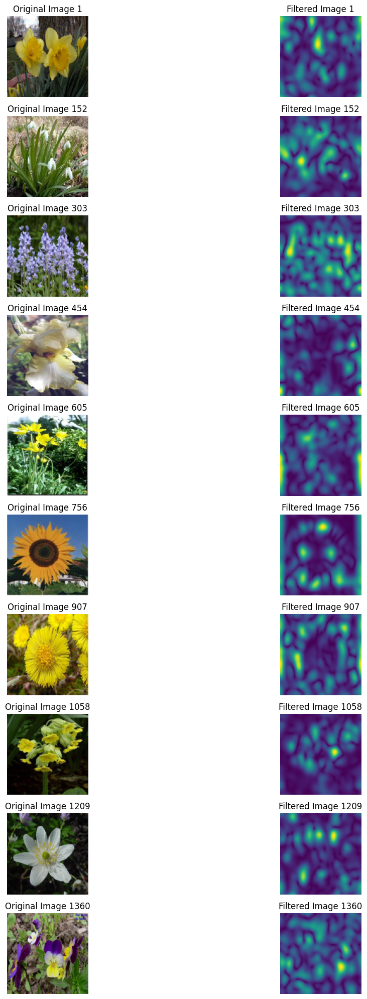

In [18]:
# Plot 10 images throughout the data and their filtered versions
indices = np.linspace(0, len(image_arrays) - 1, 10, dtype=int)
plt.figure(figsize=(15, 20))
for i, idx in enumerate(indices):
    plt.subplot(10, 2, 2 * i + 1)
    plt.imshow(image_arrays[idx])
    plt.title(f"Original Image {idx + 1}")
    plt.axis("off")

    plt.subplot(10, 2, 2 * i + 2)
    plt.imshow(np.abs(filtered_image_list[idx][0, :, :, 0]))
    plt.title(f"Filtered Image {idx + 1}")
    plt.axis("off")

plt.tight_layout()
plt.show()

Based upon an initial visual inspection, this filtering technique seems to show some promise for prediction. The filters clearly differentiate between the different images, as the filtered images all look different from one another. However, more in-depth analysis is needed to further test the gabor filters' efficacy in accomplishing the prediction task.

### KNN Classifier Performance Comparison

### Original Data

In [19]:
# Split the original data into training and testing sets
X_train_orig, X_test_orig, y_train_orig, y_test_orig = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Tune n_neighbors for the original data
param_grid = {"n_neighbors": range(1, 7)}
grid_search_orig = GridSearchCV(
    KNeighborsClassifier(), param_grid, cv=5, scoring="accuracy", n_jobs=7
)
grid_search_orig.fit(X_train_orig, y_train_orig)

best_n_neighbors_orig = grid_search_orig.best_params_["n_neighbors"]

# Create a KNeighborsClassifier with the best number of neighbors for the original data
knn_orig = KNeighborsClassifier(n_neighbors=best_n_neighbors_orig)
knn_orig.fit(X_train_orig, y_train_orig)

# Predict on the test set for the original data
y_pred_orig = knn_orig.predict(X_test_orig)

# Calculate the accuracy for the original data
accuracy_orig = accuracy_score(y_test_orig, y_pred_orig)
print(
    f"Accuracy of KNeighborsClassifier on original data: {accuracy_orig}"
)
print(f"Best n_neighbors for original data: {best_n_neighbors_orig}")

Accuracy of KNeighborsClassifier on original data: 0.31985294117647056
Best n_neighbors for original data: 1


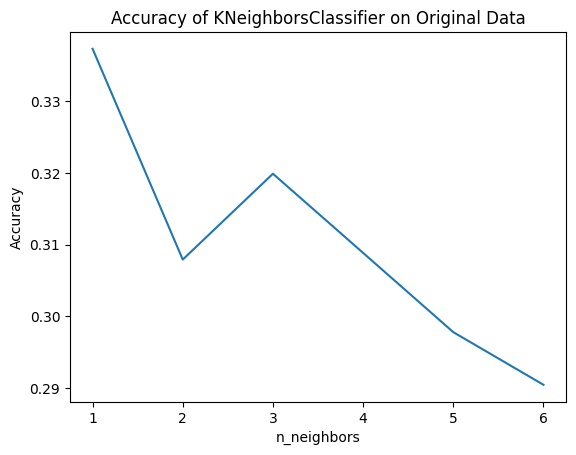

In [20]:
# Check the accuracy of each n_neighbors
results = grid_search_orig.cv_results_
plt.plot(param_grid["n_neighbors"], results["mean_test_score"])
plt.xlabel("n_neighbors")
plt.ylabel("Accuracy")
plt.title("Accuracy of KNeighborsClassifier on Original Data")
plt.show()

The general trend seen here is that the classification accuracy gets worse as the number of neighbors increases (with the exception of n_neighbors going from 2 to 3). This shows that the data may be quite nuianced (which we would expect with so many label categories) and thus requires more complex decision boundaries. There also seems to be a strong local structure within the data, as 1 neighbor produces the best accuracy (with this model, the label class of the nearest neighbor is always used as the prediction of the given observation).

### Gabor Filters

In [21]:
# Flatten the Gabor filtered images to create feature vectors
X_gabor = np.array([np.abs(img).flatten() for img in filtered_image_list])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    X_gabor, y, test_size=0.2, random_state=42
)

# Tune n_neighbors
grid_search = GridSearchCV(
    KNeighborsClassifier(), param_grid, cv=5, scoring="accuracy", n_jobs=7
)
grid_search.fit(X_train, y_train)

best_n_neighbors = grid_search.best_params_["n_neighbors"]

# Create a KNeighborsClassifier with the best number of neighbors
knn = KNeighborsClassifier(n_neighbors=best_n_neighbors)
knn.fit(X_train, y_train)

# Predict on the test set
y_pred = knn.predict(X_test)

# Calculate the accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy of KNeighborsClassifier on Gabor filter data: {accuracy}")
print(f"Best n_neighbors: {best_n_neighbors}")

python(17352) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


Accuracy of KNeighborsClassifier on Gabor filter data: 0.30514705882352944
Best n_neighbors: 1


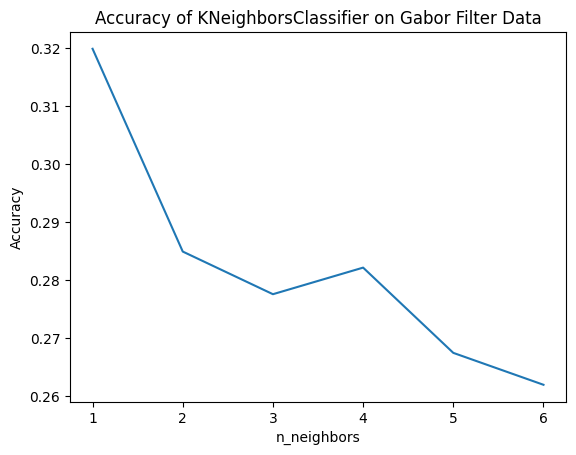

In [22]:
# Check the accuracy of each n_neighbors
results = grid_search.cv_results_
plt.plot(param_grid["n_neighbors"], results["mean_test_score"])
plt.xlabel("n_neighbors")
plt.ylabel("Accuracy")
plt.title("Accuracy of KNeighborsClassifier on Gabor Filter Data")
plt.show()

In [23]:
# Compare the accuracy of the original data and the Gabor filter data
print(
    f"Accuracy of KNeighborsClassifier on original data: {accuracy_orig}"
)
print(f"Accuracy of KNeighborsClassifier on Gabor filter data: {accuracy}")
print(
    f"Accuracy difference (Gabor - Original): {accuracy - accuracy_orig}"
)

Accuracy of KNeighborsClassifier on original data: 0.31985294117647056
Accuracy of KNeighborsClassifier on Gabor filter data: 0.30514705882352944
Accuracy difference (Gabor - Original): -0.014705882352941124


Here, we can see that the classification accuracy using the Gabor filter data is slightly worse than using the original data. This shows that this feature extraction method is not effective for our particular classification task. It is important to note, however, that other modeling frameworks such as softmax regression, tree-based classification methods, etc. may yield different results.

# DAISY Dimension Reduction with Key Point Matching

In [ ]:
daisy_features_keypoints = []

for idx, file in enumerate(image_files):
    img_path = os.path.join(dataset_path, file)
    img = Image.open(img_path).convert("RGB").resize((128, 128))
    gray_img = rgb2gray(np.array(img))

    keypoints = corner_peaks(corner_harris(gray_img), min_distance=5)

    keypoint_descriptors = []
    for kp in keypoints:
        row, col = kp
        features_keypoint = daisy(
            gray_img,
            step=1,
            radius=15,
            rings=2,
            histograms=6,
            orientations=8,
        )
        if (
            row < features_keypoint.shape[0]
            and col < features_keypoint.shape[1]
        ):
            keypoint_descriptors.append(features_keypoint[row, col])

    keypoint_descriptors = np.array(keypoint_descriptors).flatten()
    daisy_features_keypoints.append(keypoint_descriptors)

    if idx % 100 == 0:
        print(f"Processed {idx}/{len(image_files)} images")

max_length = max(len(f) for f in daisy_features_keypoints)
daisy_features_keypoints_padded = [
    np.pad(f, (0, max_length - len(f)), "constant")
    for f in daisy_features_keypoints
]
X_daisy_keypoints = np.array(
    daisy_features_keypoints_padded, dtype=np.float32
)
print(
    "Keypoint DAISY feature shape (full dataset):", X_daisy_keypoints.shape
)

X_train_keypoints, X_test_keypoints, y_train, y_test = train_test_split(
    X_daisy_keypoints, y, test_size=0.2, random_state=42
)

Processed 0/1360 images
Processed 100/1360 images
Processed 200/1360 images
Processed 300/1360 images
Processed 400/1360 images
Processed 500/1360 images
Processed 600/1360 images
Processed 700/1360 images
Processed 800/1360 images
Processed 900/1360 images
Processed 1000/1360 images
Processed 1100/1360 images
Processed 1200/1360 images
Processed 1300/1360 images
Keypoint DAISY feature shape (full dataset): (1360, 6032)


NameError: name 'SVC' is not defined

In [ ]:
# Fit a support vector machine model
model_keypoints = SVC(kernel="linear")
model_keypoints.fit(X_train_keypoints, y_train)
y_pred_keypoints = model_keypoints.predict(X_test_keypoints)
accuracy_keypoints = accuracy_score(y_test, y_pred_keypoints)

print(
    f"Accuracy with Keypoint-Matched DAISY Features (full dataset): {accuracy_keypoints:.4f}"
)

Accuracy with Keypoint-Matched DAISY Features (full dataset): 0.0515


In [ ]:
def preprocess_image(img_path):
    img = Image.open(img_path).convert("RGB")
    img = img.resize((128, 128))
    img_array = np.array(img)
    gray_img = rgb2gray(img_array)
    return gray_img


daisy_features_full = []

for idx, file in enumerate(image_files):
    img_path = os.path.join(dataset_path, file)
    img_gray = preprocess_image(img_path)

    features = daisy(
        img_gray, step=20, radius=15, rings=2, histograms=6, orientations=8
    )
    daisy_features_full.append(features.flatten())

    if idx % 100 == 0:
        print(f"Processed {idx}/{len(image_files)} images")

X_daisy_full = np.array(daisy_features_full, dtype=np.float32)
print("Full DAISY feature shape (full dataset):", X_daisy_full.shape)

X_train_full, X_test_full, y_train, y_test = train_test_split(
    X_daisy_full, y, test_size=0.2, random_state=42
)

model_full = SVC(kernel="linear")
model_full.fit(X_train_full, y_train)
y_pred_full = model_full.predict(X_test_full)
accuracy_full = accuracy_score(y_test, y_pred_full)

print(
    f"Accuracy with Full DAISY Features (full dataset): {accuracy_full:.4f}"
)

Processed 0/1360 images
Processed 100/1360 images
Processed 200/1360 images
Processed 300/1360 images
Processed 400/1360 images
Processed 500/1360 images
Processed 600/1360 images
Processed 700/1360 images
Processed 800/1360 images
Processed 900/1360 images
Processed 1000/1360 images
Processed 1100/1360 images
Processed 1200/1360 images
Processed 1300/1360 images
Full DAISY feature shape (full dataset): (1360, 2600)
Accuracy with Full DAISY Features (full dataset): 0.1360
